In [11]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import datetime
import time
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

In [29]:
# Refer to https://www.kaggle.com/uciml/pima-indians-diabetes-database
#df = pd.read_csv("https://raw.githubusercontent.com/mlg-2020/project1/master/diabetes.csv", delimiter=",", decimal=".")
df = pd.read_csv("diabetes.csv", delimiter=",", decimal=".")
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


/Users/martin/Library/Python/3.7/lib/python/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/martin/Library/Python/3.7/lib/python/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


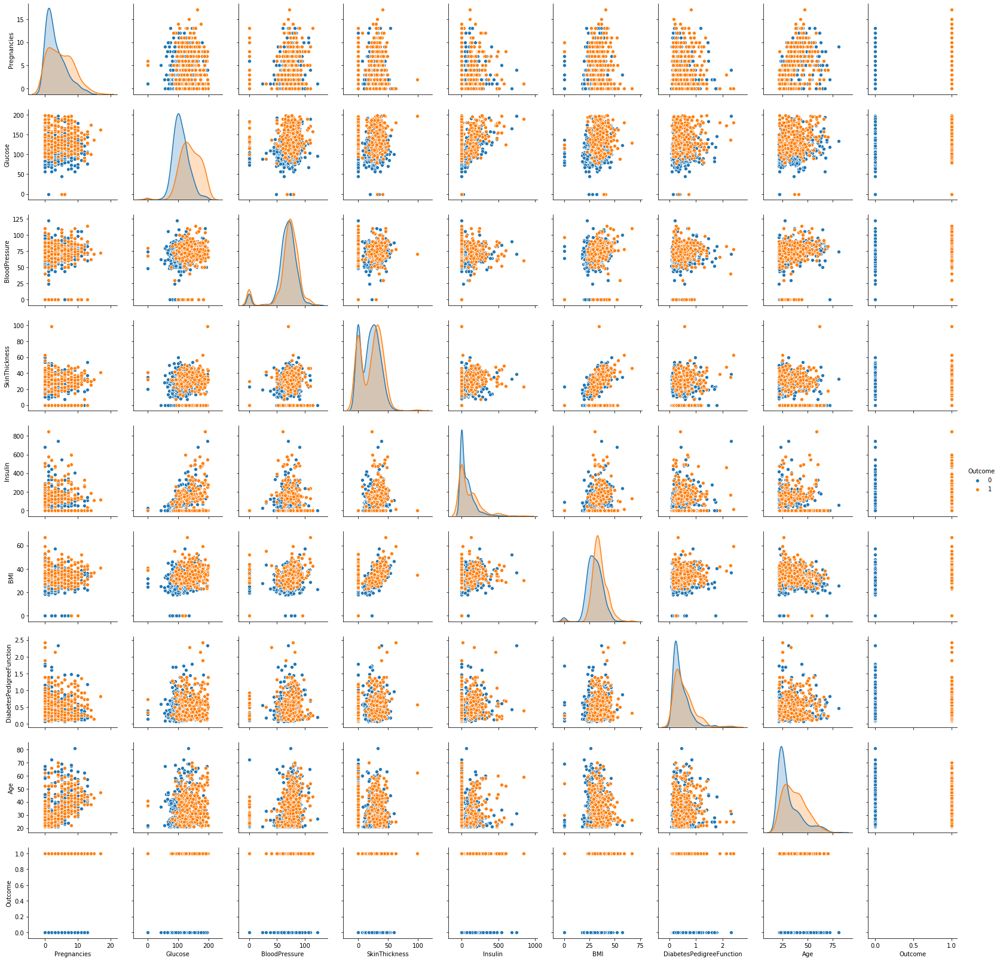

In [16]:
# Histogram of distribution and scatter plot of correlation, divided in response class "Outcome"
sns.pairplot(df, hue='Outcome')

In [22]:
# From the pairplot, we empirically see that some data is not normally distributed, lets try to take the log
df['log_Pregnancies'] = np.log10(df['Pregnancies'])
df['log_BloodPressure'] = np.log10(df['BloodPressure'])
df['log_Insulin'] = np.log10(df['Insulin'])
df['log_SkinThickness'] = np.log10(df['SkinThickness'])
# Drop the non-transformed columns
df2 = df.drop(columns = ['Pregnancies', 'BloodPressure', 'Insulin', 'SkinThickness'])

/Users/martin/Library/Python/3.7/lib/python/site-packages/pandas/core/series.py:853: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


/Users/martin/Library/Python/3.7/lib/python/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/martin/Library/Python/3.7/lib/python/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


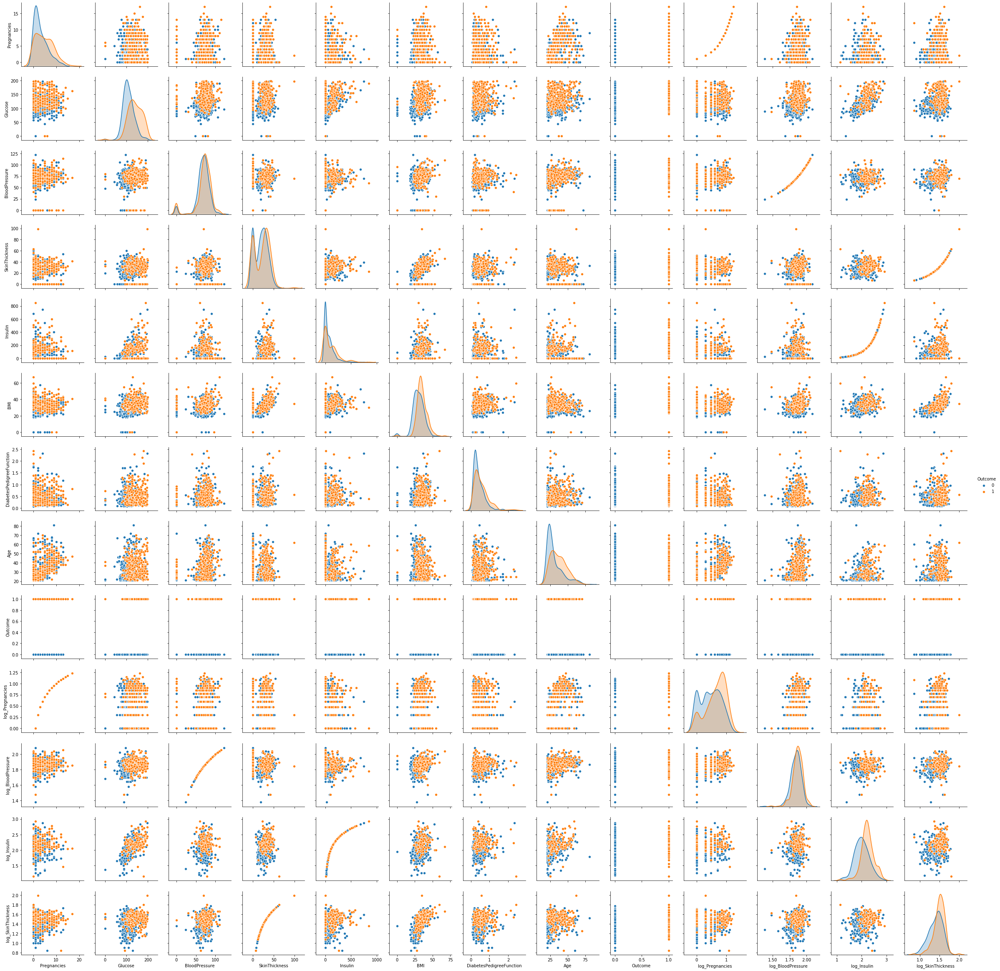

In [23]:
sns.pairplot(df, hue='Outcome')

In [24]:
df2.corr()

,Glucose,BMI,DiabetesPedigreeFunction,Age,Outcome,log_Pregnancies,log_BloodPressure,log_Insulin,log_SkinThickness
Glucose,1.000000,0.221071,0.137337,0.263514,0.466581,0.188136,0.217743,0.624036,0.203389
BMI,0.221071,1.000000,0.140647,0.036242,0.292695,0.076780,0.236905,0.254846,0.631097
DiabetesPedigreeFunction,0.137337,0.140647,1.000000,0.033561,0.173844,-0.028034,-0.005676,0.110595,0.086614
Age,0.263514,0.036242,0.033561,1.000000,0.238356,0.540036,0.326036,0.254881,0.167189
Outcome,0.466581,0.292695,0.173844,0.238356,1.000000,0.259893,0.165310,0.350499,0.262623
log_Pregnancies,0.188136,0.076780,-0.028034,0.540036,0.259893,1.000000,0.295646,0.180400,0.180120
log_BloodPressure,0.217743,0.236905,-0.005676,0.326036,0.165310,0.295646,1.000000,0.127414,0.217223
log_Insulin,0.624036,0.254846,0.110595,0.254881,0.350499,0.180400,0.127414,1.000000,0.206051
log_SkinThickness,0.203389,0.631097,0.086614,0.167189,0.262623,0.180120,0.217223,0.206051,1.000000


In [ ]:
# What about missing data? Clearly, not all people has hade pregnancies (divide by 0)